## Import things


In [ ]:
import matplotlib.pyplot as plt
import os, torch

# for prepro
import random
from torchvision import transforms
import torchvision.transforms.functional as F
from PIL import Image, ImageFilter
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

# for DataLoader
from torch.utils.data import DataLoader, random_split
from torchvision.datasets import ImageFolder
from collections import Counter

## Import Vision Transformer from torchvision
from torchvision.models import resnet50, vit_b_32
import torch.nn as nn

from sklearn.metrics import confusion_matrix

# For ViT
import torch.optim as optim

import time  # to measure time per epoch
from tqdm import tqdm

from sklearn.metrics import classification_report
from collections import defaultdict
import pandas as pd

plt.rcParams["font.family"] = "Times New Roman"

## Load Data

In [ ]:
dataset_path = r'D:/Kuliah/Matkul/Semester 7/TA/Dataset/Histogram Matching'

train_path = os.path.join(dataset_path, "Train")
valid_path = os.path.join(dataset_path, "Valid")
test_path = os.path.join(dataset_path, "Test")

## Visualize Data


Class Distribution for Train Set Distribution:
Class: R25 (Very Dark), Count: 360
Class: R35 (Dark), Count: 360
Class: R45 (Moderately Dark), Count: 360
Class: R55 (Medium), Count: 360
Class: R65 (Medium Light), Count: 360
Class: R75 (Light), Count: 360
Class: R85 (Very Light), Count: 360
Class: R95 (Extremely Light), Count: 360


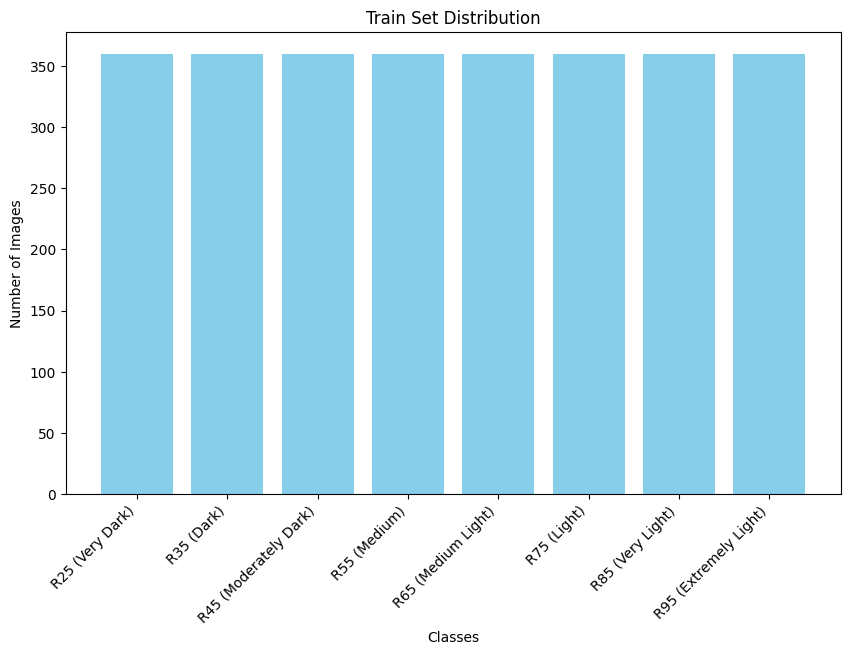


Class Distribution for Validation Set Distribution:
Class: R25 (Very Dark), Count: 45
Class: R35 (Dark), Count: 45
Class: R45 (Moderately Dark), Count: 45
Class: R55 (Medium), Count: 45
Class: R65 (Medium Light), Count: 45
Class: R75 (Light), Count: 45
Class: R85 (Very Light), Count: 45
Class: R95 (Extremely Light), Count: 45


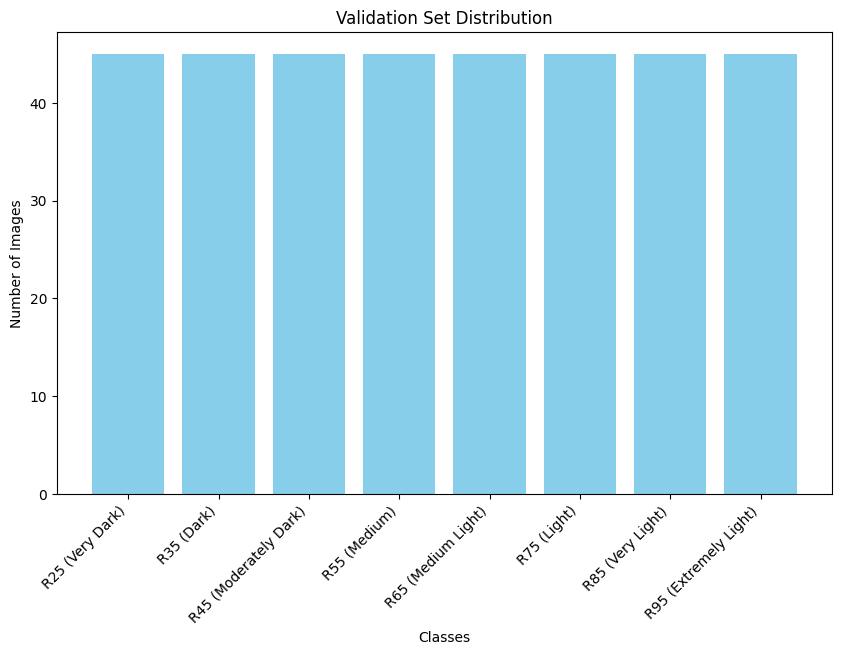


Class Distribution for Test Set Distribution:
Class: R25 (Very Dark), Count: 45
Class: R35 (Dark), Count: 45
Class: R45 (Moderately Dark), Count: 45
Class: R55 (Medium), Count: 45
Class: R65 (Medium Light), Count: 45
Class: R75 (Light), Count: 45
Class: R85 (Very Light), Count: 45
Class: R95 (Extremely Light), Count: 45


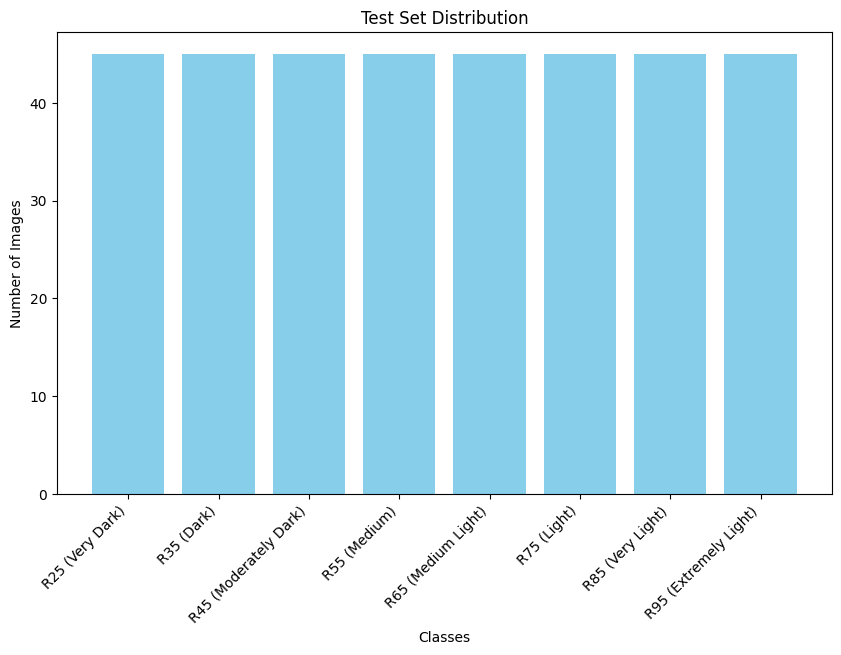

In [ ]:
# Function to calculate and plot class distribution
def plot_class_distribution(path, title):
    """
    Calculates and plots the class distribution for a given dataset path.
    Args:
        path (str): Path to the dataset folder (Train, Valid, or Test).
        title (str): Title for the plot.
    """
    # Get the class names (subfolder names)
    class_names = sorted(os.listdir(path))

    # Initialize a dictionary to store class distribution
    class_distribution = {}

    # Loop over each class folder
    for class_name in class_names:
        class_folder = os.path.join(path, class_name)
        if os.path.isdir(class_folder):  # Ensure it's a directory
            # Count the number of files (images) in each folder
            num_files = len(os.listdir(class_folder))
            class_distribution[class_name] = num_files

    # Print the class distribution
    print(f"\nClass Distribution for {title}:")
    for class_name, count in class_distribution.items():
        print(f'Class: {class_name}, Count: {count}')

    # Plot the distribution as a bar chart
    plt.figure(figsize=(10, 6))
    plt.bar(class_distribution.keys(), class_distribution.values(), color='skyblue')
    plt.xticks(rotation=45, ha='right')
    plt.title(title)
    plt.xlabel('Classes')
    plt.ylabel('Number of Images')
    plt.show()

# Plot distributions for Train, Valid, and Test datasets
plot_class_distribution(train_path, "Train Set Distribution")
plot_class_distribution(valid_path, "Validation Set Distribution")
plot_class_distribution(test_path, "Test Set Distribution")

images from Train Set Samples


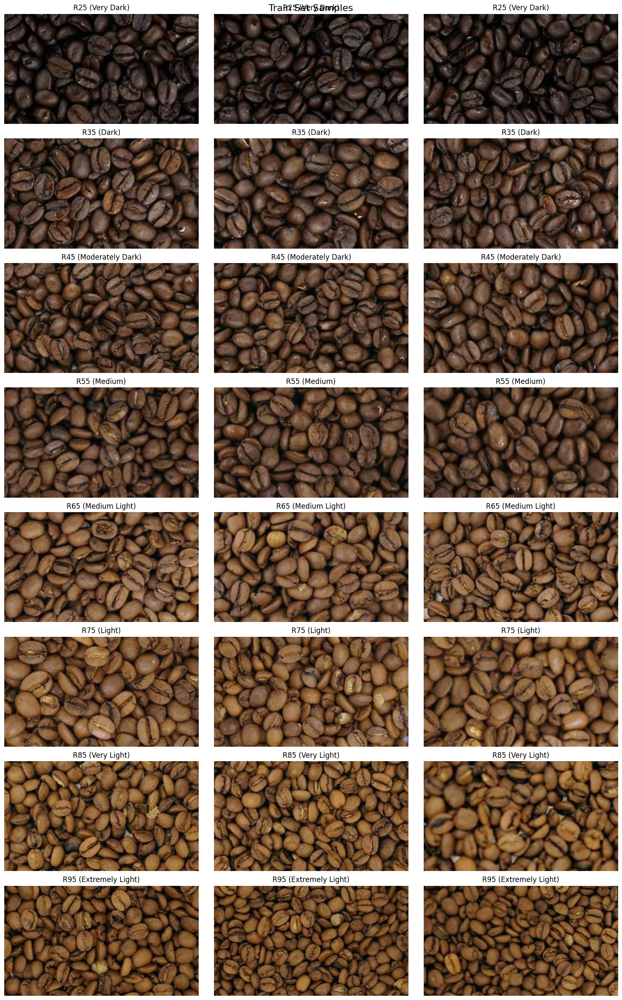

images from Validation Set Samples


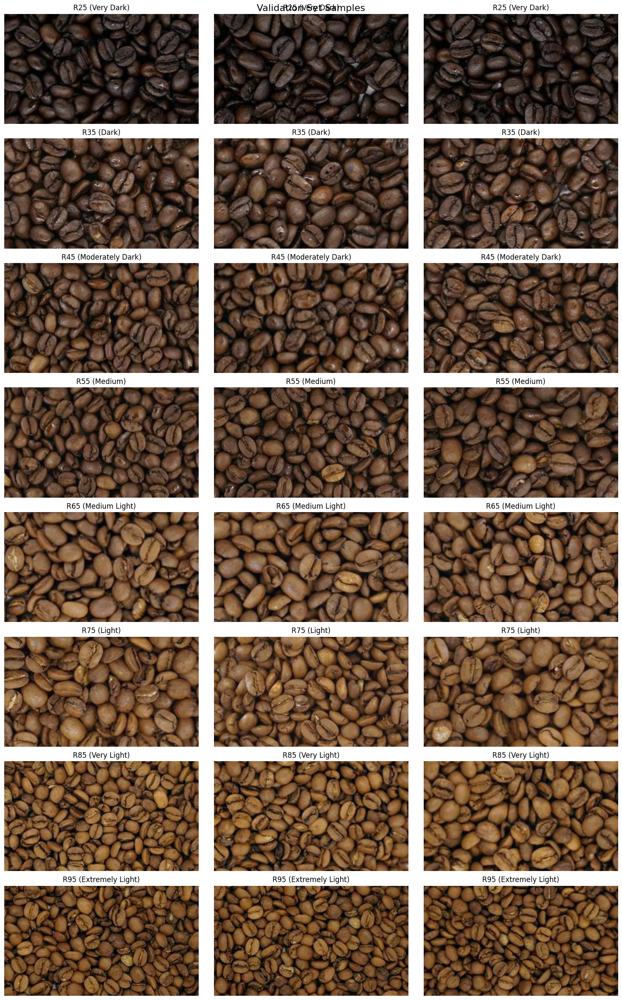

images from Test Set Samples


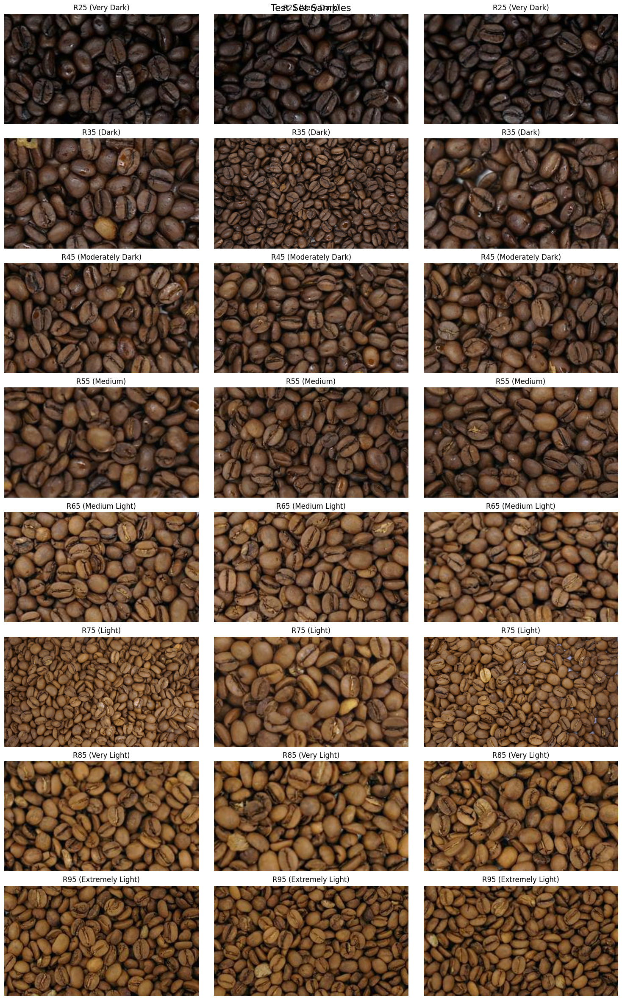

In [ ]:
# Function to display sample images per class
def display_samples_per_class(path, title, num_samples_per_class=3):
    """
    Displays a specified number of sample images per class for a given dataset path.

    Args:
        path (str): Path to the dataset folder (Train, Valid, or Test).
        title (str): Title for the figure.
        num_samples_per_class (int): Number of images to display per class.
    """
    # Get class names (subfolders)
    class_names = sorted(os.listdir(path))
    plt.figure(figsize=(15, len(class_names) * 3))

    # Loop over each class folder and display image samples
    for i, class_name in enumerate(class_names):
        class_folder = os.path.join(path, class_name)
        if os.path.isdir(class_folder):  # Ensure it's a directory
            # Get a list of all image files in the class folder
            image_files = os.listdir(class_folder)
            
            # Randomly select a few images from the class folder
            sample_images = random.sample(image_files, min(num_samples_per_class, len(image_files)))
            
            # Loop through the selected images
            for j, image_file in enumerate(sample_images):
                # Load the image
                img_path = os.path.join(class_folder, image_file)
                img = Image.open(img_path)
                
                # Plot the image
                plt.subplot(len(class_names), num_samples_per_class, i * num_samples_per_class + j + 1)
                plt.imshow(img)
                plt.title(f'{class_name}')
                plt.axis('off')

    print(f'images from {title}')            

    # Add a title to the figure
    plt.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()

# Display samples for Train, Valid, and Test datasets
display_samples_per_class(train_path, "Train Set Samples", num_samples_per_class=3)
display_samples_per_class(valid_path, "Validation Set Samples", num_samples_per_class=3)
display_samples_per_class(test_path, "Test Set Samples", num_samples_per_class=3)

## Preprocessing

In [ ]:
# Custom transform to include Equalization
class EqualizeTransform:
    def __call__(self, img):
        return F.equalize(img)
    
# Custom function to apply sharpening
def sharpen_image(image):
    return image.filter(ImageFilter.SHARPEN)

# Define the preprocessing pipeline
preprocessed_images = transforms.Compose([
    transforms.RandomResizedCrop((224, 224)),
    transforms.Lambda(lambda img: sharpen_image(img)),
    transforms.ColorJitter(
        # brightness=0.1, 
        # contrast=0.2, 
        # saturation=0.2, 
    #    hue=0.2  # Adjust color variations
    ),
    #EqualizeTransform(),  # Apply equalization
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    #transforms.ToPILImage(),
])

images_to_display = transforms.Compose([
    transforms.RandomResizedCrop((224, 224)),
    transforms.Lambda(lambda img: sharpen_image(img)),
    transforms.ColorJitter(
        # brightness=0.1, 
        # contrast=0.2, 
        # saturation=0.2, 
        #hue=0.2  # Adjust color variations
    ),
    #EqualizeTransform(),  # Apply equalization
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    transforms.ToPILImage(),
])

no_preprocessing = transforms.Compose([
    transforms.RandomResizedCrop((224, 224)),
    transforms.ToTensor(),
])


Class: R25 (Very Dark)


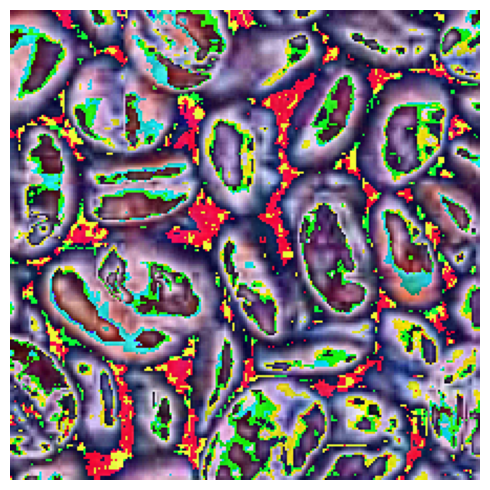

Class: R35 (Dark)


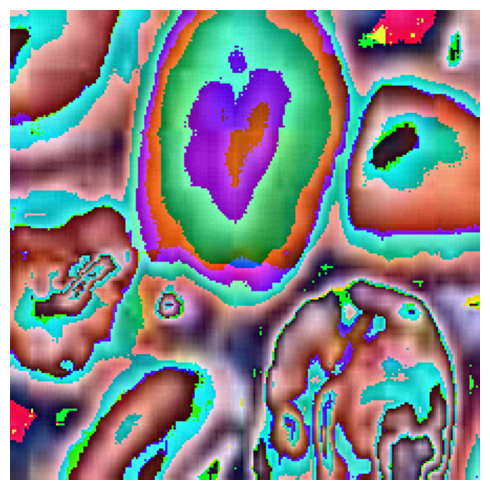

Class: R45 (Moderately Dark)


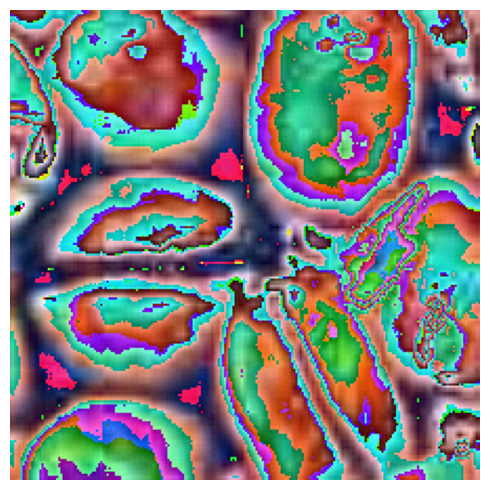

Class: R55 (Medium)


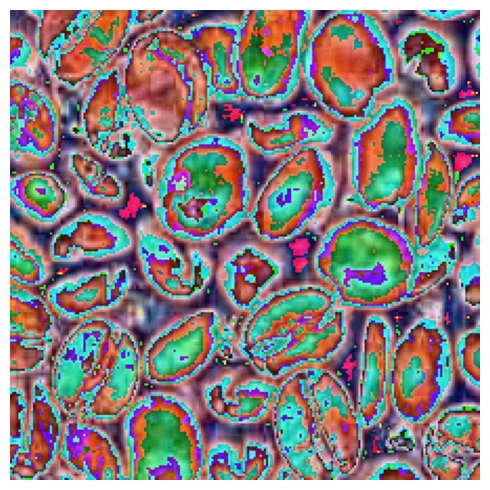

Class: R65 (Medium Light)


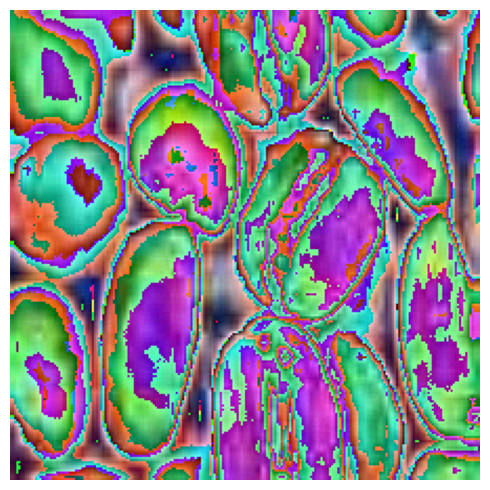

Class: R75 (Light)


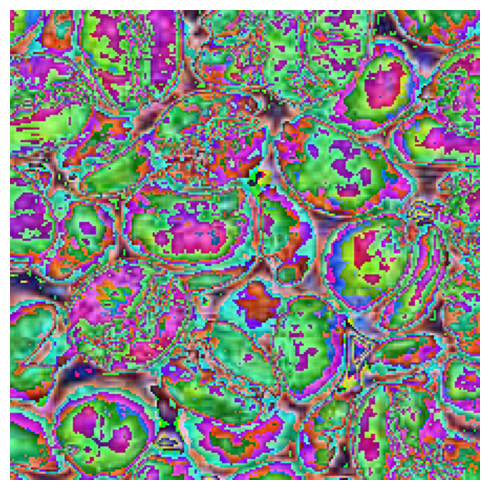

Class: R85 (Very Light)


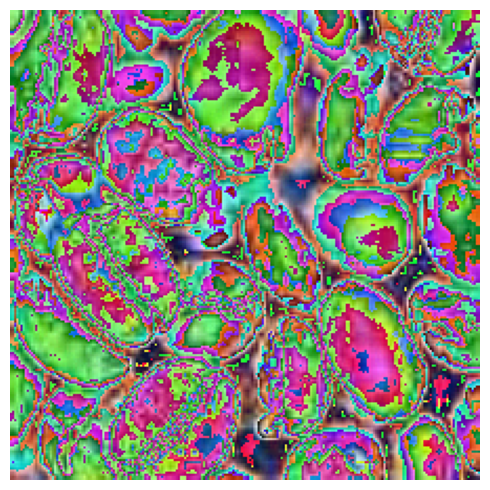

Class: R95 (Extremely Light)


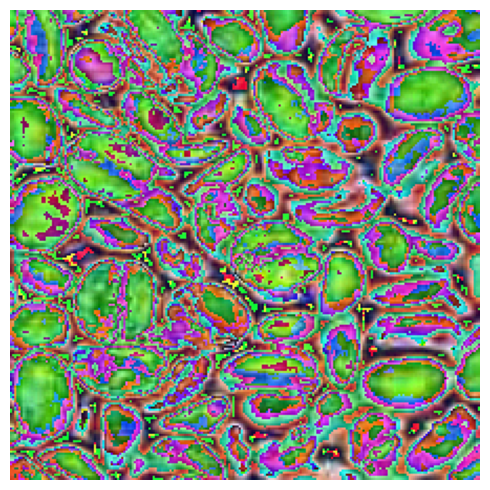

In [ ]:
# Sort the class names (subfolder names)
class_names = sorted(os.listdir(train_path))

# Loop over each class folder and display a single image sample
for class_name in class_names:
    class_folder = os.path.join(train_path, class_name)
    # Get a list of all image files in the class folder
    image_files = os.listdir(class_folder)
    
    # Randomly select a single image from the class folder
    image_file = random.choice(image_files)
    
    # Load the image
    img_path = os.path.join(class_folder, image_file)
    img = Image.open(img_path)
    
    # Apply preprocessing (assuming `images_to_display` is defined)
    preprocessed_img = images_to_display(img)
    
    # Print the class name
    print(f'Class: {class_name}')
    
    # Initialize a separate figure for each class
    plt.figure(figsize=(5, 5))
    plt.imshow(preprocessed_img)
    plt.axis('off')
    
    # Show the plot
    plt.tight_layout()
    plt.show()

### DataLoader

In [ ]:
# Load datasets
train_dataset = ImageFolder(root=train_path, transform=preprocessed_images)
valid_dataset = ImageFolder(root=valid_path, transform=preprocessed_images)
test_dataset = ImageFolder(root=test_path, transform=preprocessed_images)

# Data loaders
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(valid_dataset, batch_size=16, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

# Print dataset sizes
print(f"Number of training images: {len(train_dataset)}")
print(f"Number of validation images: {len(valid_dataset)}")
print(f"Number of test images: {len(test_dataset)}")

# Print class-to-index mapping
print(f"Class-to-Label Mapping: {train_dataset.class_to_idx}")

Number of training images: 2880
Number of validation images: 360
Number of test images: 360
Class-to-Label Mapping: {'R25 (Very Dark)': 0, 'R35 (Dark)': 1, 'R45 (Moderately Dark)': 2, 'R55 (Medium)': 3, 'R65 (Medium Light)': 4, 'R75 (Light)': 5, 'R85 (Very Light)': 6, 'R95 (Extremely Light)': 7}


In [ ]:
# Get class names from the train dataset
class_names = {v: k for k, v in train_dataset.class_to_idx.items()}  # Reverse the mapping
target_names = [class_names[i] for i in range(len(class_names))]

# Print class-to-index mapping
print("Class-to-Label Mapping:")
for idx, name in enumerate(target_names):
    print(f"{idx}: {name}")

Class-to-Label Mapping:
0: R25 (Very Dark)
1: R35 (Dark)
2: R45 (Moderately Dark)
3: R55 (Medium)
4: R65 (Medium Light)
5: R75 (Light)
6: R85 (Very Light)
7: R95 (Extremely Light)


In [ ]:
# Function to count the number of images per class in an ImageFolder dataset
def count_images_per_class(dataset):
    """
    Counts the number of images for each class in the dataset.
    Args:
        dataset: ImageFolder dataset.
    Returns:
        Dictionary with class indices as keys and counts as values.
    """
    class_counts = Counter()
    for _, label in dataset.samples:  # Iterate through all (image_path, label) pairs
        class_counts[label] += 1
    return class_counts

# Count the number of images per class in Train, Validation, and Test datasets
train_class_counts = count_images_per_class(train_dataset)
val_class_counts = count_images_per_class(valid_dataset)
test_class_counts = count_images_per_class(test_dataset)

# Get the class names from the train dataset
class_names = {v: k for k, v in train_dataset.class_to_idx.items()}

# Print the dataset sizes
print(f"\nTrain Dataset Size: {len(train_dataset)}")
print(f"Validation Dataset Size: {len(valid_dataset)}")
print(f"Test Dataset Size: {len(test_dataset)}")

# Display the class distributions
print("\nTraining Set Class Distribution:")
for class_idx, count in train_class_counts.items():
    print(f"{class_names[class_idx]}: {count} images")

print("\nValidation Set Class Distribution:")
for class_idx, count in val_class_counts.items():
    print(f"{class_names[class_idx]}: {count} images")

print("\nTest Set Class Distribution:")
for class_idx, count in test_class_counts.items():
    print(f"{class_names[class_idx]}: {count} images")


Train Dataset Size: 2880
Validation Dataset Size: 360
Test Dataset Size: 360

Training Set Class Distribution:
R25 (Very Dark): 360 images
R35 (Dark): 360 images
R45 (Moderately Dark): 360 images
R55 (Medium): 360 images
R65 (Medium Light): 360 images
R75 (Light): 360 images
R85 (Very Light): 360 images
R95 (Extremely Light): 360 images

Validation Set Class Distribution:
R25 (Very Dark): 45 images
R35 (Dark): 45 images
R45 (Moderately Dark): 45 images
R55 (Medium): 45 images
R65 (Medium Light): 45 images
R75 (Light): 45 images
R85 (Very Light): 45 images
R95 (Extremely Light): 45 images

Test Set Class Distribution:
R25 (Very Dark): 45 images
R35 (Dark): 45 images
R45 (Moderately Dark): 45 images
R55 (Medium): 45 images
R65 (Medium Light): 45 images
R75 (Light): 45 images
R85 (Very Light): 45 images
R95 (Extremely Light): 45 images


# ResNet50

### Create Model

#### Initialize ResNet50


In [ ]:
# Initialize ResNet50
resnet_model = resnet50(pretrained=False)  # Use pretrained weights on ImageNet

# Customize the model for your dataset
num_classes = len(train_dataset.classes)  # Get the number of classes from the dataset
resnet_model.fc = nn.Linear(resnet_model.fc.in_features, num_classes)  # Replace the final layer

# Move the model to the appropriate device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
resnet_model = resnet_model.to(device)

print(f"Model initialized with {num_classes} output classes.")

c:\Users\DHAFINDRA\AppData\Local\Programs\Python\Python310\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
c:\Users\DHAFINDRA\AppData\Local\Programs\Python\Python310\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


Model initialized with 8 output classes.


#### Define Loss and Optimizer

In [ ]:
# Define the loss function
criterion = torch.nn.CrossEntropyLoss()

# Define the optimizer (using the ResNet model parameters)
optimizer = optim.AdamW(resnet_model.parameters(), lr=1e-5, weight_decay=0.01)

print("Loss function and optimizer initialized.")

Loss function and optimizer initialized.


### Training

In [ ]:
num_epochs = 100
train_losses = []
val_losses = []
train_accuracies = []
val_accuracies = []
best_val_accuracy = 0.0  
best_model_path = 'best_weights_resnet50.pth'  

for epoch in range(num_epochs):
    resnet_model.train()  # Set model to training mode
    running_loss = 0.0
    correct_train = 0
    total_train = 0
    start_time = time.time()  # Record start time for each epoch

    # Training
    with tqdm(total=len(train_loader), desc=f"Epoch {epoch+1}/{num_epochs}", unit='batch') as pbar:
        for batch_idx, (inputs, labels) in enumerate(train_loader):
            inputs, labels = inputs.to(device), labels.long().to(device)

            optimizer.zero_grad()

            # Forward pass
            outputs = resnet_model(inputs)
            loss = criterion(outputs, labels)

            # Backward pass and optimization
            loss.backward()
            optimizer.step()

            running_loss += loss.item()

            # Track accuracy for training set
            _, predicted_train = torch.max(outputs, 1)
            total_train += labels.size(0)
            correct_train += (predicted_train == labels).sum().item()

            # Update tqdm bar with custom metrics
            current_loss = loss.item()
            avg_loss = running_loss / (batch_idx + 1)  # Running average loss

            pbar.set_postfix({
                'Batch Loss': current_loss, 
                'Avg Loss': avg_loss, 
                'LR': optimizer.param_groups[0]['lr']  # Display current learning rate
            })
            pbar.update(1)

    # Record the epoch loss and accuracy for training
    avg_epoch_loss = running_loss / len(train_loader)
    train_losses.append(avg_epoch_loss)
    train_accuracy = 100 * correct_train / total_train
    train_accuracies.append(train_accuracy)

    # Validation
    resnet_model.eval()  # Set model to evaluation mode
    correct_val = 0
    total_val = 0
    running_val_loss = 0.0

    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = resnet_model(inputs)
            loss = criterion(outputs, labels)
            running_val_loss += loss.item()

            _, predicted_val = torch.max(outputs, 1)
            total_val += labels.size(0)
            correct_val += (predicted_val == labels).sum().item()

    avg_val_loss = running_val_loss / len(val_loader)
    val_losses.append(avg_val_loss)
    val_accuracy = 100 * correct_val / total_val
    val_accuracies.append(val_accuracy)

    # Save the model if validation accuracy improves
    if val_accuracy > best_val_accuracy:
        best_val_accuracy = val_accuracy
        torch.save(resnet_model.state_dict(), best_model_path)
        print(f'Best model saved with Val Acc: {val_accuracy}%')

    # Calculate and display epoch duration
    epoch_duration = time.time() - start_time
    print(f'Epoch {epoch+1}/{num_epochs}, Train Loss: {avg_epoch_loss}, Train Acc: {train_accuracy}%, Val Loss: {avg_val_loss}, Val Acc: {val_accuracy}%, Time: {epoch_duration:.2f}s')

# Load the best model weights after training
resnet_model.load_state_dict(torch.load(best_model_path))
print(f"Loaded best model weights with Val Acc: {best_val_accuracy}%")


Epoch 1/100: 100%|██████████| 180/180 [01:00<00:00,  2.98batch/s, Batch Loss=1.95, Avg Loss=1.92, LR=1e-5]


Best model saved with Val Acc: 36.94444444444444%
Epoch 1/100, Train Loss: 1.9172950035995908, Train Acc: 25.625%, Val Loss: 1.8038371905036594, Val Acc: 36.94444444444444%, Time: 63.07s


Epoch 2/100: 100%|██████████| 180/180 [00:58<00:00,  3.08batch/s, Batch Loss=1.62, Avg Loss=1.59, LR=1e-5]


Best model saved with Val Acc: 48.05555555555556%
Epoch 2/100, Train Loss: 1.5888061490323808, Train Acc: 40.38194444444444%, Val Loss: 1.3095871838538542, Val Acc: 48.05555555555556%, Time: 61.02s


Epoch 3/100: 100%|██████████| 180/180 [00:58<00:00,  3.07batch/s, Batch Loss=0.989, Avg Loss=1.17, LR=1e-5]


Best model saved with Val Acc: 57.77777777777778%
Epoch 3/100, Train Loss: 1.1698304550515282, Train Acc: 52.986111111111114%, Val Loss: 0.9777437322165655, Val Acc: 57.77777777777778%, Time: 61.13s


Epoch 4/100: 100%|██████████| 180/180 [00:58<00:00,  3.08batch/s, Batch Loss=0.899, Avg Loss=1.01, LR=1e-5]


Best model saved with Val Acc: 69.72222222222223%
Epoch 4/100, Train Loss: 1.0134162667724822, Train Acc: 58.125%, Val Loss: 0.7836543689279453, Val Acc: 69.72222222222223%, Time: 60.99s


Epoch 5/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.763, Avg Loss=0.891, LR=1e-5]


Best model saved with Val Acc: 75.55555555555556%
Epoch 5/100, Train Loss: 0.8912451787127389, Train Acc: 63.78472222222222%, Val Loss: 0.5652708365460453, Val Acc: 75.55555555555556%, Time: 61.04s


Epoch 6/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.499, Avg Loss=0.696, LR=1e-5]


Best model saved with Val Acc: 76.38888888888889%
Epoch 6/100, Train Loss: 0.695871549182468, Train Acc: 71.77083333333333%, Val Loss: 0.48577865816490806, Val Acc: 76.38888888888889%, Time: 60.90s


Epoch 7/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.699, Avg Loss=0.603, LR=1e-5]


Best model saved with Val Acc: 79.72222222222223%
Epoch 7/100, Train Loss: 0.6028747662074037, Train Acc: 75.41666666666667%, Val Loss: 0.4540036296188507, Val Acc: 79.72222222222223%, Time: 60.74s


Epoch 8/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.368, Avg Loss=0.559, LR=1e-5]


Best model saved with Val Acc: 80.83333333333333%
Epoch 8/100, Train Loss: 0.5592100211315685, Train Acc: 76.42361111111111%, Val Loss: 0.40800137708530476, Val Acc: 80.83333333333333%, Time: 60.68s


Epoch 9/100: 100%|██████████| 180/180 [00:57<00:00,  3.11batch/s, Batch Loss=0.965, Avg Loss=0.505, LR=1e-5]


Best model saved with Val Acc: 90.27777777777777%
Epoch 9/100, Train Loss: 0.5054614482654466, Train Acc: 80.55555555555556%, Val Loss: 0.2863371921905681, Val Acc: 90.27777777777777%, Time: 60.58s


Epoch 10/100: 100%|██████████| 180/180 [00:57<00:00,  3.11batch/s, Batch Loss=0.394, Avg Loss=0.479, LR=1e-5]


Best model saved with Val Acc: 90.55555555555556%
Epoch 10/100, Train Loss: 0.47936527530352274, Train Acc: 79.75694444444444%, Val Loss: 0.2610066798515618, Val Acc: 90.55555555555556%, Time: 60.56s


Epoch 11/100: 100%|██████████| 180/180 [00:58<00:00,  3.08batch/s, Batch Loss=0.319, Avg Loss=0.472, LR=1e-5]


Epoch 11/100, Train Loss: 0.4716121248486969, Train Acc: 81.14583333333333%, Val Loss: 0.2853561214515534, Val Acc: 88.88888888888889%, Time: 60.88s


Epoch 12/100: 100%|██████████| 180/180 [00:58<00:00,  3.07batch/s, Batch Loss=0.893, Avg Loss=0.439, LR=1e-5]


Epoch 12/100, Train Loss: 0.4392390173756414, Train Acc: 81.5625%, Val Loss: 0.3211068159409637, Val Acc: 86.11111111111111%, Time: 61.09s


Epoch 13/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.297, Avg Loss=0.451, LR=1e-5]


Best model saved with Val Acc: 90.83333333333333%
Epoch 13/100, Train Loss: 0.45102393076651626, Train Acc: 81.66666666666667%, Val Loss: 0.2751812049612889, Val Acc: 90.83333333333333%, Time: 60.86s


Epoch 14/100: 100%|██████████| 180/180 [00:57<00:00,  3.11batch/s, Batch Loss=0.357, Avg Loss=0.415, LR=1e-5]


Epoch 14/100, Train Loss: 0.4154636636790302, Train Acc: 83.54166666666667%, Val Loss: 0.2665020739128206, Val Acc: 90.0%, Time: 60.35s


Epoch 15/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.263, Avg Loss=0.404, LR=1e-5] 


Best model saved with Val Acc: 93.33333333333333%
Epoch 15/100, Train Loss: 0.40389714443849195, Train Acc: 84.0625%, Val Loss: 0.21542198449859154, Val Acc: 93.33333333333333%, Time: 60.66s


Epoch 16/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.285, Avg Loss=0.39, LR=1e-5]  


Epoch 16/100, Train Loss: 0.38995267355607616, Train Acc: 85.34722222222223%, Val Loss: 0.21906499917942868, Val Acc: 92.5%, Time: 60.70s


Epoch 17/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.168, Avg Loss=0.349, LR=1e-5] 


Epoch 17/100, Train Loss: 0.34923799712624815, Train Acc: 85.97222222222223%, Val Loss: 0.21047776446009622, Val Acc: 91.66666666666667%, Time: 60.63s


Epoch 18/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.514, Avg Loss=0.393, LR=1e-5] 


Epoch 18/100, Train Loss: 0.3925815293772353, Train Acc: 84.30555555555556%, Val Loss: 0.2883904147083345, Val Acc: 87.22222222222223%, Time: 60.57s


Epoch 19/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.216, Avg Loss=0.323, LR=1e-5] 


Best model saved with Val Acc: 96.94444444444444%
Epoch 19/100, Train Loss: 0.32281818667219747, Train Acc: 87.46527777777777%, Val Loss: 0.13599401219044407, Val Acc: 96.94444444444444%, Time: 60.87s


Epoch 20/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.274, Avg Loss=0.364, LR=1e-5] 


Epoch 20/100, Train Loss: 0.3639216451181306, Train Acc: 86.25%, Val Loss: 0.19434608911979012, Val Acc: 92.77777777777777%, Time: 60.77s


Epoch 21/100: 100%|██████████| 180/180 [00:58<00:00,  3.08batch/s, Batch Loss=0.504, Avg Loss=0.311, LR=1e-5] 


Epoch 21/100, Train Loss: 0.31119525480187604, Train Acc: 88.4375%, Val Loss: 0.1683116926882497, Val Acc: 94.72222222222223%, Time: 60.94s


Epoch 22/100: 100%|██████████| 180/180 [00:58<00:00,  3.08batch/s, Batch Loss=0.32, Avg Loss=0.295, LR=1e-5]  


Epoch 22/100, Train Loss: 0.2948343247175217, Train Acc: 88.92361111111111%, Val Loss: 0.13801889939476614, Val Acc: 94.44444444444444%, Time: 60.80s


Epoch 23/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.684, Avg Loss=0.293, LR=1e-5] 


Epoch 23/100, Train Loss: 0.2925105569056339, Train Acc: 88.88888888888889%, Val Loss: 0.11380866656849242, Val Acc: 96.11111111111111%, Time: 60.59s


Epoch 24/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.404, Avg Loss=0.287, LR=1e-5] 


Epoch 24/100, Train Loss: 0.2871834559986989, Train Acc: 88.68055555555556%, Val Loss: 0.16280920738759247, Val Acc: 95.27777777777777%, Time: 60.75s


Epoch 25/100: 100%|██████████| 180/180 [00:57<00:00,  3.11batch/s, Batch Loss=0.898, Avg Loss=0.267, LR=1e-5] 


Epoch 25/100, Train Loss: 0.2668119877369867, Train Acc: 90.34722222222223%, Val Loss: 0.14547488866778818, Val Acc: 95.55555555555556%, Time: 60.32s


Epoch 26/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.267, Avg Loss=0.279, LR=1e-5] 


Epoch 26/100, Train Loss: 0.278554604947567, Train Acc: 89.75694444444444%, Val Loss: 0.13496848863660885, Val Acc: 94.72222222222223%, Time: 60.63s


Epoch 27/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.16, Avg Loss=0.272, LR=1e-5]  


Best model saved with Val Acc: 97.22222222222223%
Epoch 27/100, Train Loss: 0.27238868134510186, Train Acc: 90.03472222222223%, Val Loss: 0.09082606555666248, Val Acc: 97.22222222222223%, Time: 60.66s


Epoch 28/100: 100%|██████████| 180/180 [00:58<00:00,  3.08batch/s, Batch Loss=0.0674, Avg Loss=0.264, LR=1e-5]


Best model saved with Val Acc: 97.5%
Epoch 28/100, Train Loss: 0.264167704878168, Train Acc: 90.24305555555556%, Val Loss: 0.09560695773436, Val Acc: 97.5%, Time: 61.00s


Epoch 29/100: 100%|██████████| 180/180 [00:58<00:00,  3.08batch/s, Batch Loss=0.269, Avg Loss=0.257, LR=1e-5] 


Epoch 29/100, Train Loss: 0.2566130091332727, Train Acc: 89.65277777777777%, Val Loss: 0.10159378095388251, Val Acc: 96.66666666666667%, Time: 60.85s


Epoch 30/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.302, Avg Loss=0.235, LR=1e-5] 


Epoch 30/100, Train Loss: 0.23466665673380097, Train Acc: 91.5625%, Val Loss: 0.09881814403216475, Val Acc: 96.94444444444444%, Time: 60.55s


Epoch 31/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.303, Avg Loss=0.242, LR=1e-5] 


Epoch 31/100, Train Loss: 0.2423127360228035, Train Acc: 90.86805555555556%, Val Loss: 0.1041482367006171, Val Acc: 96.38888888888889%, Time: 60.75s


Epoch 32/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.177, Avg Loss=0.222, LR=1e-5] 


Epoch 32/100, Train Loss: 0.22155852122232317, Train Acc: 92.08333333333333%, Val Loss: 0.10753642874339636, Val Acc: 96.38888888888889%, Time: 60.55s


Epoch 33/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.216, Avg Loss=0.217, LR=1e-5] 


Best model saved with Val Acc: 97.77777777777777%
Epoch 33/100, Train Loss: 0.21669874880462886, Train Acc: 91.97916666666667%, Val Loss: 0.09282014174032552, Val Acc: 97.77777777777777%, Time: 60.74s


Epoch 34/100: 100%|██████████| 180/180 [00:58<00:00,  3.08batch/s, Batch Loss=0.116, Avg Loss=0.2, LR=1e-5]   


Epoch 34/100, Train Loss: 0.19973869036055272, Train Acc: 92.8125%, Val Loss: 0.10695629140220421, Val Acc: 96.66666666666667%, Time: 60.85s


Epoch 35/100: 100%|██████████| 180/180 [00:58<00:00,  3.08batch/s, Batch Loss=0.208, Avg Loss=0.189, LR=1e-5] 


Epoch 35/100, Train Loss: 0.18853594719742736, Train Acc: 93.19444444444444%, Val Loss: 0.1110913997374313, Val Acc: 96.66666666666667%, Time: 60.85s


Epoch 36/100: 100%|██████████| 180/180 [00:57<00:00,  3.11batch/s, Batch Loss=0.05, Avg Loss=0.214, LR=1e-5]  


Best model saved with Val Acc: 98.61111111111111%
Epoch 36/100, Train Loss: 0.21351176900789143, Train Acc: 91.94444444444444%, Val Loss: 0.05678511451064285, Val Acc: 98.61111111111111%, Time: 60.47s


Epoch 37/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.331, Avg Loss=0.208, LR=1e-5] 


Epoch 37/100, Train Loss: 0.2075749456261595, Train Acc: 92.39583333333333%, Val Loss: 0.0637967427977381, Val Acc: 98.33333333333333%, Time: 60.60s


Epoch 38/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.247, Avg Loss=0.209, LR=1e-5] 


Epoch 38/100, Train Loss: 0.2090837992934717, Train Acc: 92.29166666666667%, Val Loss: 0.08521029555097061, Val Acc: 97.77777777777777%, Time: 60.76s


Epoch 39/100: 100%|██████████| 180/180 [00:58<00:00,  3.08batch/s, Batch Loss=0.0439, Avg Loss=0.196, LR=1e-5]


Epoch 39/100, Train Loss: 0.19617081481135554, Train Acc: 92.60416666666667%, Val Loss: 0.07694471385532423, Val Acc: 98.05555555555556%, Time: 60.92s


Epoch 40/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.106, Avg Loss=0.2, LR=1e-5]   


Epoch 40/100, Train Loss: 0.19979781366677749, Train Acc: 93.05555555555556%, Val Loss: 0.08658047020435333, Val Acc: 97.77777777777777%, Time: 60.67s


Epoch 41/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.0574, Avg Loss=0.195, LR=1e-5]


Epoch 41/100, Train Loss: 0.19476428364093104, Train Acc: 92.60416666666667%, Val Loss: 0.08312441920608525, Val Acc: 97.22222222222223%, Time: 60.71s


Epoch 42/100: 100%|██████████| 180/180 [00:58<00:00,  3.08batch/s, Batch Loss=0.0432, Avg Loss=0.171, LR=1e-5]


Epoch 42/100, Train Loss: 0.1709211209995879, Train Acc: 93.4375%, Val Loss: 0.06796795754875663, Val Acc: 97.77777777777777%, Time: 60.96s


Epoch 43/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.0703, Avg Loss=0.185, LR=1e-5]


Epoch 43/100, Train Loss: 0.1852859196667042, Train Acc: 93.22916666666667%, Val Loss: 0.08044394571081047, Val Acc: 97.22222222222223%, Time: 60.58s


Epoch 44/100: 100%|██████████| 180/180 [00:58<00:00,  3.08batch/s, Batch Loss=0.2, Avg Loss=0.161, LR=1e-5]   


Epoch 44/100, Train Loss: 0.16119469142415457, Train Acc: 94.40972222222223%, Val Loss: 0.10085992831306573, Val Acc: 96.11111111111111%, Time: 60.84s


Epoch 45/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.0707, Avg Loss=0.187, LR=1e-5]


Epoch 45/100, Train Loss: 0.18713897914729186, Train Acc: 93.26388888888889%, Val Loss: 0.09386484754150329, Val Acc: 96.11111111111111%, Time: 60.49s


Epoch 46/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.0284, Avg Loss=0.16, LR=1e-5] 


Epoch 46/100, Train Loss: 0.16009537506227692, Train Acc: 94.51388888888889%, Val Loss: 0.07243521876491445, Val Acc: 97.77777777777777%, Time: 60.69s


Epoch 47/100: 100%|██████████| 180/180 [00:57<00:00,  3.11batch/s, Batch Loss=0.0811, Avg Loss=0.157, LR=1e-5]


Epoch 47/100, Train Loss: 0.15735560845997598, Train Acc: 94.34027777777777%, Val Loss: 0.0820202982539068, Val Acc: 96.38888888888889%, Time: 60.41s


Epoch 48/100: 100%|██████████| 180/180 [00:57<00:00,  3.10batch/s, Batch Loss=0.212, Avg Loss=0.158, LR=1e-5] 


Epoch 48/100, Train Loss: 0.15782231268110788, Train Acc: 93.61111111111111%, Val Loss: 0.05866094623469626, Val Acc: 98.61111111111111%, Time: 60.48s


Epoch 49/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.0472, Avg Loss=0.192, LR=1e-5]


Epoch 49/100, Train Loss: 0.19168859633306662, Train Acc: 93.47222222222223%, Val Loss: 0.12558186679076322, Val Acc: 95.83333333333333%, Time: 60.50s


Epoch 50/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.137, Avg Loss=0.162, LR=1e-5] 


Epoch 50/100, Train Loss: 0.16223860677952567, Train Acc: 94.0625%, Val Loss: 0.08335995802949385, Val Acc: 96.94444444444444%, Time: 60.63s


Epoch 51/100: 100%|██████████| 180/180 [00:57<00:00,  3.12batch/s, Batch Loss=0.0201, Avg Loss=0.16, LR=1e-5] 


Best model saved with Val Acc: 99.16666666666667%
Epoch 51/100, Train Loss: 0.15989381551432114, Train Acc: 94.27083333333333%, Val Loss: 0.041254183612181805, Val Acc: 99.16666666666667%, Time: 60.36s


Epoch 52/100: 100%|██████████| 180/180 [00:57<00:00,  3.10batch/s, Batch Loss=0.0693, Avg Loss=0.152, LR=1e-5]


Epoch 52/100, Train Loss: 0.15155689985129153, Train Acc: 94.16666666666667%, Val Loss: 0.064699928939302, Val Acc: 97.77777777777777%, Time: 60.42s


Epoch 53/100: 100%|██████████| 180/180 [00:58<00:00,  3.08batch/s, Batch Loss=0.0661, Avg Loss=0.155, LR=1e-5] 


Epoch 53/100, Train Loss: 0.15501331065833154, Train Acc: 94.54861111111111%, Val Loss: 0.07469952732081646, Val Acc: 97.5%, Time: 60.86s


Epoch 54/100: 100%|██████████| 180/180 [00:58<00:00,  3.08batch/s, Batch Loss=0.115, Avg Loss=0.153, LR=1e-5] 


Epoch 54/100, Train Loss: 0.1526163423071719, Train Acc: 94.6875%, Val Loss: 0.055034074855148385, Val Acc: 98.88888888888889%, Time: 60.96s


Epoch 55/100: 100%|██████████| 180/180 [00:59<00:00,  3.05batch/s, Batch Loss=0.0567, Avg Loss=0.134, LR=1e-5] 


Epoch 55/100, Train Loss: 0.13362106865064965, Train Acc: 95.20833333333333%, Val Loss: 0.04258445671660846, Val Acc: 98.88888888888889%, Time: 61.46s


Epoch 56/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.0476, Avg Loss=0.16, LR=1e-5]  


Epoch 56/100, Train Loss: 0.16019592203924227, Train Acc: 94.16666666666667%, Val Loss: 0.06382786082205079, Val Acc: 98.05555555555556%, Time: 60.68s


Epoch 57/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.0655, Avg Loss=0.127, LR=1e-5] 


Epoch 57/100, Train Loss: 0.1265831037476245, Train Acc: 95.69444444444444%, Val Loss: 0.05946400717695487, Val Acc: 98.33333333333333%, Time: 60.52s


Epoch 58/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.165, Avg Loss=0.151, LR=1e-5]  


Epoch 58/100, Train Loss: 0.15053529250952932, Train Acc: 94.54861111111111%, Val Loss: 0.06835710125438788, Val Acc: 96.66666666666667%, Time: 60.72s


Epoch 59/100: 100%|██████████| 180/180 [00:57<00:00,  3.11batch/s, Batch Loss=0.177, Avg Loss=0.164, LR=1e-5]  


Epoch 59/100, Train Loss: 0.1641900120044334, Train Acc: 93.47222222222223%, Val Loss: 0.1035290149751666, Val Acc: 95.55555555555556%, Time: 60.39s


Epoch 60/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.283, Avg Loss=0.141, LR=1e-5] 


Epoch 60/100, Train Loss: 0.14058976957264047, Train Acc: 95.27777777777777%, Val Loss: 0.0814042652703432, Val Acc: 97.5%, Time: 60.54s


Epoch 61/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.0754, Avg Loss=0.147, LR=1e-5] 


Epoch 61/100, Train Loss: 0.14672543990115325, Train Acc: 95.06944444444444%, Val Loss: 0.04126275577278727, Val Acc: 98.61111111111111%, Time: 60.75s


Epoch 62/100: 100%|██████████| 180/180 [00:57<00:00,  3.11batch/s, Batch Loss=0.208, Avg Loss=0.158, LR=1e-5]  


Epoch 62/100, Train Loss: 0.157741193442295, Train Acc: 94.09722222222223%, Val Loss: 0.03960362263909622, Val Acc: 98.88888888888889%, Time: 60.40s


Epoch 63/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.134, Avg Loss=0.145, LR=1e-5] 


Epoch 63/100, Train Loss: 0.14475177793194435, Train Acc: 95.03472222222223%, Val Loss: 0.051425614401839834, Val Acc: 98.61111111111111%, Time: 60.60s


Epoch 64/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.0645, Avg Loss=0.132, LR=1e-5]


Epoch 64/100, Train Loss: 0.13155040604114118, Train Acc: 95.20833333333333%, Val Loss: 0.04780887201345847, Val Acc: 97.77777777777777%, Time: 60.74s


Epoch 65/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.0465, Avg Loss=0.135, LR=1e-5]


Epoch 65/100, Train Loss: 0.13493425581190321, Train Acc: 94.79166666666667%, Val Loss: 0.03731899170594735, Val Acc: 99.16666666666667%, Time: 60.64s


Epoch 66/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.0871, Avg Loss=0.126, LR=1e-5]


Best model saved with Val Acc: 99.72222222222223%
Epoch 66/100, Train Loss: 0.12634852039110328, Train Acc: 95.90277777777777%, Val Loss: 0.033326441526815354, Val Acc: 99.72222222222223%, Time: 60.93s


Epoch 67/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.0114, Avg Loss=0.12, LR=1e-5]  


Epoch 67/100, Train Loss: 0.1202311543126901, Train Acc: 95.72916666666667%, Val Loss: 0.045676905426459954, Val Acc: 98.88888888888889%, Time: 60.59s


Epoch 68/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.189, Avg Loss=0.124, LR=1e-5]  


Epoch 68/100, Train Loss: 0.12427530378206736, Train Acc: 95.45138888888889%, Val Loss: 0.07426075202301549, Val Acc: 97.22222222222223%, Time: 60.79s


Epoch 69/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.0586, Avg Loss=0.14, LR=1e-5]  


Epoch 69/100, Train Loss: 0.14018316183032262, Train Acc: 95.41666666666667%, Val Loss: 0.07446206634378304, Val Acc: 96.94444444444444%, Time: 60.54s


Epoch 70/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.228, Avg Loss=0.125, LR=1e-5]  


Epoch 70/100, Train Loss: 0.12471865013293508, Train Acc: 95.625%, Val Loss: 0.05227103496746049, Val Acc: 98.33333333333333%, Time: 60.66s


Epoch 71/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.0584, Avg Loss=0.111, LR=1e-5] 


Epoch 71/100, Train Loss: 0.11141638988370282, Train Acc: 95.79861111111111%, Val Loss: 0.04025452300708782, Val Acc: 98.61111111111111%, Time: 60.54s


Epoch 72/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.0854, Avg Loss=0.138, LR=1e-5] 


Epoch 72/100, Train Loss: 0.1382565347244963, Train Acc: 94.93055555555556%, Val Loss: 0.04637630583222389, Val Acc: 98.61111111111111%, Time: 60.71s


Epoch 73/100: 100%|██████████| 180/180 [00:57<00:00,  3.10batch/s, Batch Loss=0.00826, Avg Loss=0.122, LR=1e-5]


Epoch 73/100, Train Loss: 0.1222532605441908, Train Acc: 95.9375%, Val Loss: 0.053797293051383865, Val Acc: 97.5%, Time: 60.39s


Epoch 74/100: 100%|██████████| 180/180 [00:58<00:00,  3.08batch/s, Batch Loss=0.108, Avg Loss=0.124, LR=1e-5]  


Epoch 74/100, Train Loss: 0.12398252060843838, Train Acc: 96.18055555555556%, Val Loss: 0.046253299154910645, Val Acc: 98.88888888888889%, Time: 60.82s


Epoch 75/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.0259, Avg Loss=0.115, LR=1e-5] 


Epoch 75/100, Train Loss: 0.11523850531213814, Train Acc: 95.76388888888889%, Val Loss: 0.06170852435626211, Val Acc: 98.33333333333333%, Time: 60.65s


Epoch 76/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.0387, Avg Loss=0.0976, LR=1e-5] 


Epoch 76/100, Train Loss: 0.09760573107956184, Train Acc: 96.45833333333333%, Val Loss: 0.06836536020969304, Val Acc: 97.22222222222223%, Time: 60.77s


Epoch 77/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.212, Avg Loss=0.118, LR=1e-5]  


Epoch 77/100, Train Loss: 0.11807607436914824, Train Acc: 95.9375%, Val Loss: 0.0514538816578747, Val Acc: 97.77777777777777%, Time: 60.47s


Epoch 78/100: 100%|██████████| 180/180 [00:57<00:00,  3.13batch/s, Batch Loss=0.237, Avg Loss=0.119, LR=1e-5]  


Epoch 78/100, Train Loss: 0.11919588660433268, Train Acc: 95.65972222222223%, Val Loss: 0.049629653614829294, Val Acc: 98.33333333333333%, Time: 60.05s


Epoch 79/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.0307, Avg Loss=0.119, LR=1e-5] 


Epoch 79/100, Train Loss: 0.11940880840282059, Train Acc: 95.83333333333333%, Val Loss: 0.04429504390598437, Val Acc: 98.33333333333333%, Time: 60.76s


Epoch 80/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.0306, Avg Loss=0.0992, LR=1e-5] 


Epoch 80/100, Train Loss: 0.09918274115124304, Train Acc: 96.31944444444444%, Val Loss: 0.03322321180578159, Val Acc: 98.88888888888889%, Time: 60.63s


Epoch 81/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.174, Avg Loss=0.119, LR=1e-5]  


Epoch 81/100, Train Loss: 0.11879203938102971, Train Acc: 95.90277777777777%, Val Loss: 0.03390651893657733, Val Acc: 99.72222222222223%, Time: 60.64s


Epoch 82/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.0956, Avg Loss=0.107, LR=1e-5] 


Epoch 82/100, Train Loss: 0.10723863116387898, Train Acc: 96.38888888888889%, Val Loss: 0.061615025848605794, Val Acc: 98.05555555555556%, Time: 60.52s


Epoch 83/100: 100%|██████████| 180/180 [00:57<00:00,  3.11batch/s, Batch Loss=0.208, Avg Loss=0.123, LR=1e-5]  


Epoch 83/100, Train Loss: 0.12322051054927417, Train Acc: 95.3125%, Val Loss: 0.052021295643340716, Val Acc: 98.05555555555556%, Time: 60.20s


Epoch 84/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.0709, Avg Loss=0.106, LR=1e-5] 


Epoch 84/100, Train Loss: 0.1062064436238466, Train Acc: 96.35416666666667%, Val Loss: 0.06513833949587855, Val Acc: 97.5%, Time: 60.55s


Epoch 85/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.214, Avg Loss=0.12, LR=1e-5]   


Epoch 85/100, Train Loss: 0.11987000214091191, Train Acc: 95.52083333333333%, Val Loss: 0.03840521905492452, Val Acc: 99.16666666666667%, Time: 60.67s


Epoch 86/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.0154, Avg Loss=0.0949, LR=1e-5] 


Epoch 86/100, Train Loss: 0.09485041852393705, Train Acc: 96.875%, Val Loss: 0.03491579460577392, Val Acc: 99.16666666666667%, Time: 60.48s


Epoch 87/100: 100%|██████████| 180/180 [00:57<00:00,  3.10batch/s, Batch Loss=0.0519, Avg Loss=0.0985, LR=1e-5] 


Epoch 87/100, Train Loss: 0.09850096928421408, Train Acc: 96.66666666666667%, Val Loss: 0.04816994202733242, Val Acc: 98.33333333333333%, Time: 60.40s


Epoch 88/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.158, Avg Loss=0.1, LR=1e-5]     


Epoch 88/100, Train Loss: 0.10042061214335263, Train Acc: 96.38888888888889%, Val Loss: 0.03863039679202737, Val Acc: 98.33333333333333%, Time: 60.47s


Epoch 89/100: 100%|██████████| 180/180 [00:58<00:00,  3.08batch/s, Batch Loss=0.371, Avg Loss=0.114, LR=1e-5]  


Epoch 89/100, Train Loss: 0.11366586237240375, Train Acc: 96.00694444444444%, Val Loss: 0.04197624035773713, Val Acc: 98.88888888888889%, Time: 60.87s


Epoch 90/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.0563, Avg Loss=0.112, LR=1e-5] 


Epoch 90/100, Train Loss: 0.11195637794314987, Train Acc: 95.9375%, Val Loss: 0.04351209700056959, Val Acc: 98.88888888888889%, Time: 60.59s


Epoch 91/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.0153, Avg Loss=0.115, LR=1e-5] 


Epoch 91/100, Train Loss: 0.11540117810428556, Train Acc: 96.07638888888889%, Val Loss: 0.024766330741366128, Val Acc: 99.16666666666667%, Time: 60.60s


Epoch 92/100: 100%|██████████| 180/180 [00:58<00:00,  3.08batch/s, Batch Loss=0.0461, Avg Loss=0.0943, LR=1e-5] 


Epoch 92/100, Train Loss: 0.09431053275087227, Train Acc: 96.52777777777777%, Val Loss: 0.03683709734278913, Val Acc: 98.88888888888889%, Time: 60.88s


Epoch 93/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.0665, Avg Loss=0.092, LR=1e-5]  


Epoch 93/100, Train Loss: 0.09204650349242406, Train Acc: 96.66666666666667%, Val Loss: 0.0478587122020342, Val Acc: 98.05555555555556%, Time: 60.50s


Epoch 94/100: 100%|██████████| 180/180 [00:57<00:00,  3.11batch/s, Batch Loss=0.0695, Avg Loss=0.11, LR=1e-5]  


Epoch 94/100, Train Loss: 0.10960918952866147, Train Acc: 95.65972222222223%, Val Loss: 0.025751625802671617, Val Acc: 99.44444444444444%, Time: 60.38s


Epoch 95/100: 100%|██████████| 180/180 [00:58<00:00,  3.09batch/s, Batch Loss=0.0186, Avg Loss=0.0977, LR=1e-5] 


Epoch 95/100, Train Loss: 0.09773210550322094, Train Acc: 96.25%, Val Loss: 0.046451876448649586, Val Acc: 98.88888888888889%, Time: 60.66s


Epoch 96/100: 100%|██████████| 180/180 [00:58<00:00,  3.10batch/s, Batch Loss=0.209, Avg Loss=0.1, LR=1e-5]    


Epoch 96/100, Train Loss: 0.10012029589593617, Train Acc: 96.49305555555556%, Val Loss: 0.06404704151867444, Val Acc: 96.66666666666667%, Time: 60.55s


Epoch 97/100: 100%|██████████| 180/180 [00:57<00:00,  3.11batch/s, Batch Loss=0.0488, Avg Loss=0.089, LR=1e-5]  


Epoch 97/100, Train Loss: 0.08904643015832536, Train Acc: 96.94444444444444%, Val Loss: 0.052331933232894895, Val Acc: 98.33333333333333%, Time: 60.33s


Epoch 98/100: 100%|██████████| 180/180 [00:58<00:00,  3.08batch/s, Batch Loss=0.0458, Avg Loss=0.0848, LR=1e-5] 


Epoch 98/100, Train Loss: 0.08475532691744674, Train Acc: 96.97916666666667%, Val Loss: 0.04824764239374022, Val Acc: 98.33333333333333%, Time: 60.87s


Epoch 99/100: 100%|██████████| 180/180 [00:58<00:00,  3.08batch/s, Batch Loss=0.0488, Avg Loss=0.0981, LR=1e-5] 


Epoch 99/100, Train Loss: 0.09811202152890877, Train Acc: 96.38888888888889%, Val Loss: 0.052324003455198734, Val Acc: 97.5%, Time: 60.90s


Epoch 100/100: 100%|██████████| 180/180 [00:58<00:00,  3.08batch/s, Batch Loss=0.1, Avg Loss=0.0881, LR=1e-5]    


Epoch 100/100, Train Loss: 0.08808839515808763, Train Acc: 96.59722222222223%, Val Loss: 0.0606977188423195, Val Acc: 96.94444444444444%, Time: 60.82s
Loaded best model weights with Val Acc: 99.72222222222223%


#### classification report

In [ ]:
# Load the best model weights
resnet_model.load_state_dict(torch.load("best_weights_resnet50.pth"))
resnet_model.eval()  # Set the model to evaluation mode

# Training set evaluation
correct_train = 0
total_train = 0

# Initialize lists to store true and predicted labels for the training set
all_true_labels_train = []
all_predicted_labels_train = []

with torch.no_grad():
    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = resnet_model(inputs)
        _, predicted_train = torch.max(outputs, 1)

        # Store true and predicted labels
        all_true_labels_train.extend(labels.cpu().numpy())
        all_predicted_labels_train.extend(predicted_train.cpu().numpy())

        total_train += labels.size(0)
        correct_train += (predicted_train == labels).sum().item()

# Calculate training accuracy
train_accuracy = 100 * correct_train / total_train
print(f'Train Accuracy: {train_accuracy:.4f}%')

# Calculate precision, recall, and F1-score for training set
report_train_dict = classification_report(all_true_labels_train, all_predicted_labels_train, 
                                          target_names=target_names, output_dict=True)

# Convert to DataFrame for better formatting
report_train_df = pd.DataFrame(report_train_dict).transpose()

# Round the scores to 4 decimal places
report_train_df = report_train_df.round(4)

# Print the formatted classification report
print("Training Set Classification Report:")
print(report_train_df)

Train Accuracy: 98.0556%
Training Set Classification Report:
                       precision  recall  f1-score    support
R25 (Very Dark)           1.0000  1.0000    1.0000   360.0000
R35 (Dark)                0.9780  0.9861    0.9820   360.0000
R45 (Moderately Dark)     0.9674  0.9056    0.9354   360.0000
R55 (Medium)              0.9339  0.9806    0.9566   360.0000
R65 (Medium Light)        0.9862  0.9944    0.9903   360.0000
R75 (Light)               0.9944  0.9861    0.9902   360.0000
R85 (Very Light)          0.9890  0.9972    0.9931   360.0000
R95 (Extremely Light)     0.9972  0.9944    0.9958   360.0000
accuracy                  0.9806  0.9806    0.9806     0.9806
macro avg                 0.9808  0.9806    0.9804  2880.0000
weighted avg              0.9808  0.9806    0.9804  2880.0000


#### confusion matrix

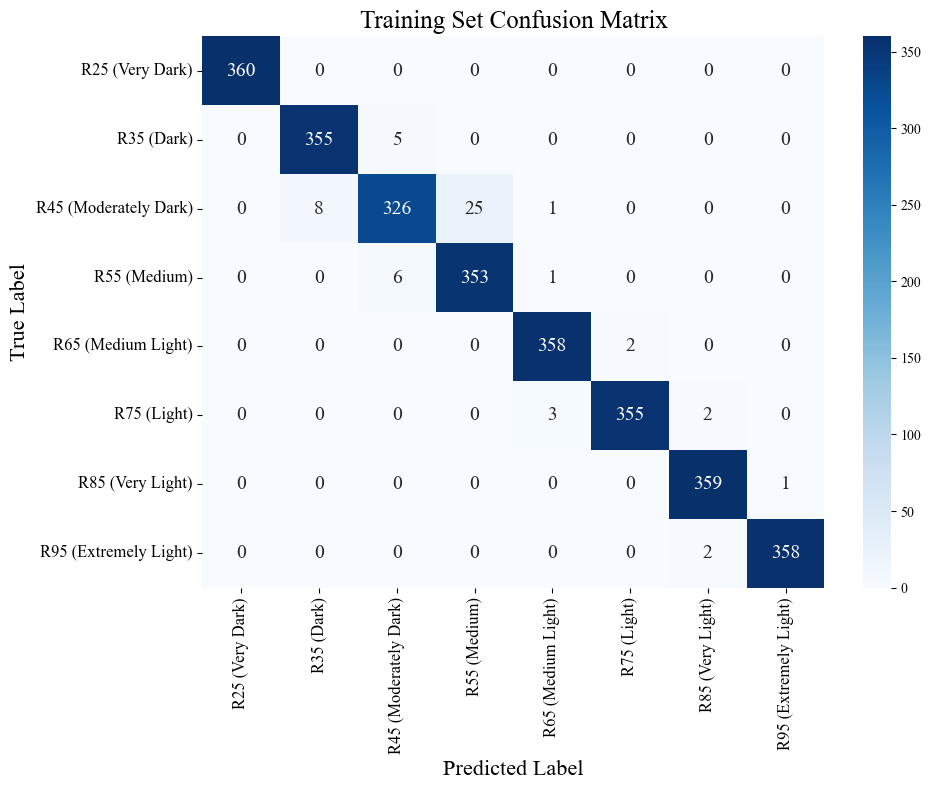

In [ ]:
# Training Set Confusion Matrix
conf_matrix_train = confusion_matrix(all_true_labels_train, all_predicted_labels_train)

fontsizetitle = 24
fontsizelabel = 20
fontsizeticks = 20

# Generate the confusion matrix for the training set
conf_matrix_train = confusion_matrix(all_true_labels_train, all_predicted_labels_train)

# Plot the confusion matrix for the training set
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix_train, annot=True, fmt="d", cmap="Blues", 
            xticklabels=target_names, 
            yticklabels=target_names,
            annot_kws={"size": 14})
plt.xlabel('Predicted Label', fontsize=fontsizelabel)
plt.ylabel('True Label',fontsize=fontsizelabel)
plt.title('Training Set Confusion Matrix',fontsize=fontsizetitle)
plt.xticks(fontsize=fontsizeticks)
plt.yticks(fontsize=fontsizeticks)
plt.tight_layout()
plt.show()

### Test Set ...

#### classification report

In [ ]:
# Load the best model weights
resnet_model.load_state_dict(torch.load("best_weights_resnet50.pth"))
resnet_model.eval()  # Set the model to evaluation mode

# Test set evaluation
correct_test = 0
total_test = 0

# Initialize lists to store true and predicted labels for the test set
all_true_labels_test = []
all_predicted_labels_test = []

with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = resnet_model(inputs)
        _, predicted_test = torch.max(outputs, 1)

        # Store true and predicted labels
        all_true_labels_test.extend(labels.cpu().numpy())
        all_predicted_labels_test.extend(predicted_test.cpu().numpy())

        total_test += labels.size(0)
        correct_test += (predicted_test == labels).sum().item()

# Calculate test accuracy
test_accuracy = 100 * correct_test / total_test
print(f'Test Accuracy: {test_accuracy:.4f}%')

# Calculate precision, recall, and F1-score for test set
report_test_dict = classification_report(all_true_labels_test, all_predicted_labels_test, 
                                         target_names=target_names, output_dict=True)

# Convert to DataFrame for better formatting
report_test_df = pd.DataFrame(report_test_dict).transpose()

# Round the scores to 4 decimal places
report_test_df = report_test_df.round(4)

# Print the formatted classification report
print("Test Set Classification Report:")
print(report_test_df)

Test Accuracy: 94.4444%
Test Set Classification Report:
                       precision  recall  f1-score   support
R25 (Very Dark)           0.9574  1.0000    0.9783   45.0000
R35 (Dark)                0.9778  0.9778    0.9778   45.0000
R45 (Moderately Dark)     0.8409  0.8222    0.8315   45.0000
R55 (Medium)              0.8864  0.8667    0.8764   45.0000
R65 (Medium Light)        1.0000  0.9556    0.9773   45.0000
R75 (Light)               1.0000  0.9333    0.9655   45.0000
R85 (Very Light)          0.9000  1.0000    0.9474   45.0000
R95 (Extremely Light)     1.0000  1.0000    1.0000   45.0000
accuracy                  0.9444  0.9444    0.9444    0.9444
macro avg                 0.9453  0.9444    0.9443  360.0000
weighted avg              0.9453  0.9444    0.9443  360.0000


#### confusion matrix

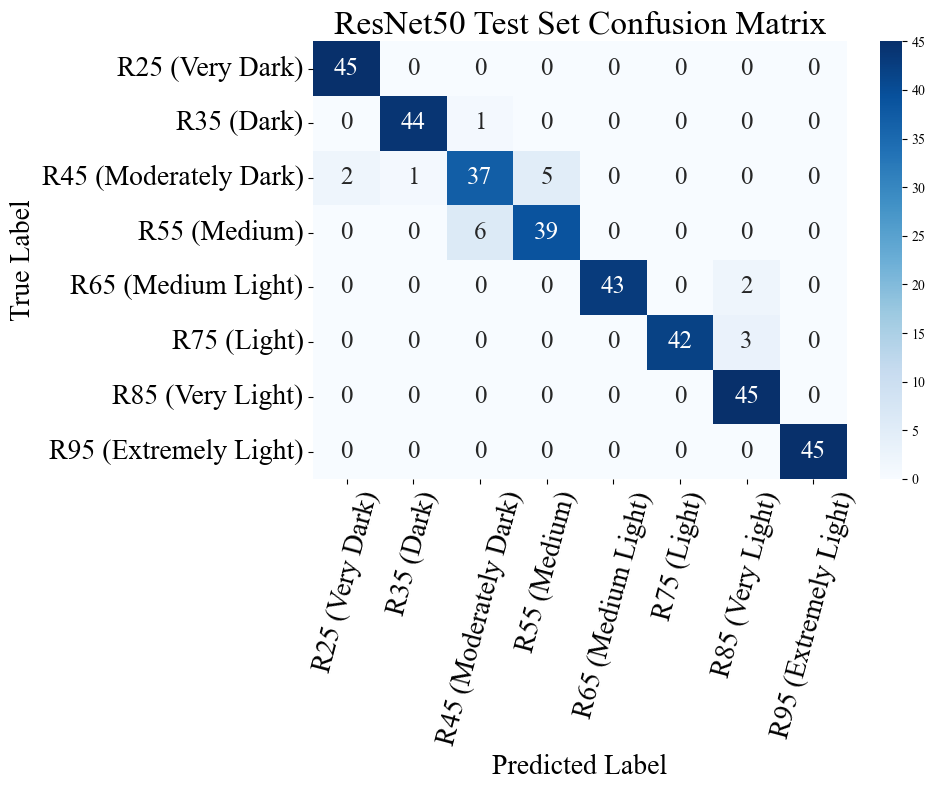

In [ ]:
# Generate the confusion matrix for the test set
conf_matrix_test = confusion_matrix(all_true_labels_test, all_predicted_labels_test)

# Plot the confusion matrix
plt.figure(figsize=(10, 8))  # Increased figure size for better resolution
sns.heatmap(conf_matrix_test, annot=True, fmt="d", cmap="Blues", 
            xticklabels=target_names, 
            yticklabels=target_names,
            annot_kws={"size": 18})  # Larger font size for annotations
plt.xlabel('Predicted Label', fontsize=fontsizelabel)
plt.ylabel('True Label', fontsize=fontsizelabel)
plt.title('ResNet50 Test Set Confusion Matrix', fontsize=fontsizetitle)
plt.xticks(fontsize=fontsizeticks, rotation=75)
plt.yticks(fontsize=fontsizeticks)
plt.tight_layout()
plt.show()

### Show Graph

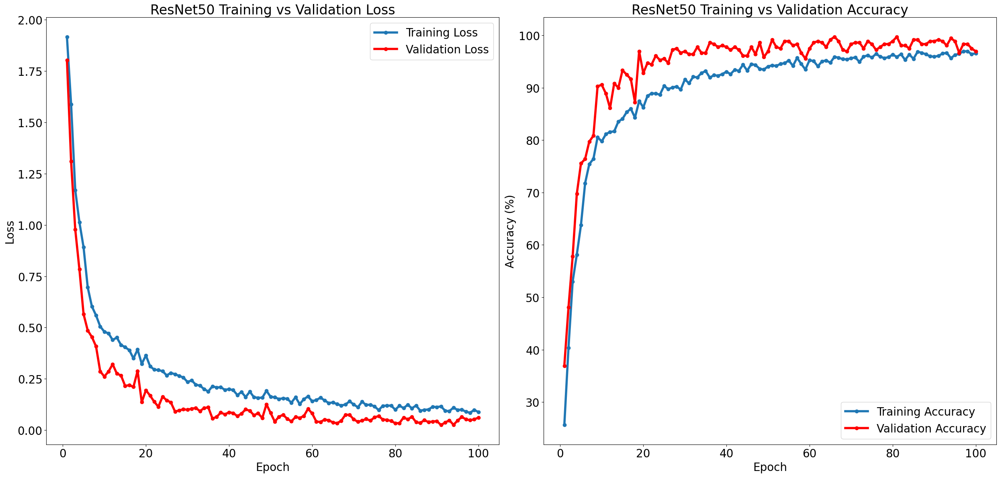

In [ ]:
# Plotting Loss (Training vs Validation)
plt.figure(figsize=(25, 12))  # Increased figure size for better resolution

# Accuracy
plt.subplot(1, 2, 2)
plt.plot(range(1, num_epochs + 1), train_accuracies, label='Training Accuracy', marker='o', linewidth=4)
plt.plot(range(1, num_epochs + 1), val_accuracies, label='Validation Accuracy', marker='o', color='red', linewidth=4)
plt.title('ResNet50 Training vs Validation Accuracy', fontsize=fontsizetitle)
plt.xlabel('Epoch', fontsize=fontsizelabel)
plt.ylabel('Accuracy (%)', fontsize=fontsizelabel)
plt.legend(fontsize=fontsizeticks)
plt.xticks(fontsize=fontsizeticks)
plt.yticks(fontsize=fontsizeticks)

# Loss
plt.subplot(1, 2, 1)
plt.plot(range(1, num_epochs + 1), train_losses, label='Training Loss', marker='o', linewidth=4)
plt.plot(range(1, num_epochs + 1), val_losses, label='Validation Loss', marker='o', color='red', linewidth=4)
plt.title('ResNet50 Training vs Validation Loss', fontsize=fontsizetitle)
plt.xlabel('Epoch', fontsize=fontsizelabel)
plt.ylabel('Loss', fontsize=fontsizelabel)
plt.legend(fontsize=fontsizeticks)
plt.xticks(fontsize=fontsizeticks)
plt.yticks(fontsize=fontsizeticks)

plt.tight_layout()
plt.show()

### Save Model

In [ ]:
torch.save(resnet_model.state_dict(), "resnet50_best_weights.pth")